In [2]:
import os
import torch 
from utils.common import load_config
from models.denoiser import get_denoiser
from models.classifier import UnetResNet50

# load model
pretrain_model_path = './weights/fingerprint_extractor.pth'
device = 'cuda:1'
config = load_config('configs.{}'.format('test'))

pre_model = torch.load(pretrain_model_path, map_location='cpu')
config.class_num = int(pre_model['state_dict']['model.classification_head.3.weight'].shape[0])
model = UnetResNet50(class_num=config.class_num)
model.load_state_dict(pre_model['state_dict'])
model = model.to(device)
model.eval()
denoise_func = get_denoiser(1, device)

## 1:1 Model Verification Cases

### This task aims at verifying whether two generated images are from the same model by fingerprint extraction.

### It is important to note that, to test the generalization ability in the open environment, our pretrained fingerprint extractor producing these results is solely trained on synthetic models, without having seen any images from the real generative models tested below.

In [12]:
from PIL import Image
import matplotlib.pyplot as plt

from utils.evaluation import cosin_metric
from utils.common import get_input_data
from data.dataset import slide_crop_image
import torchvision.transforms as transforms

def get_sample(img_path):
    norm_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])

    img = Image.open(img_path).convert('RGB')
    img_width, img_height = img.size
    if img_width > config.crop_size[0] and img_height > config.crop_size[1]:
        img_crops = slide_crop_image(img, crop_size=config.crop_size, \
                                        stride1=(img_width-config.crop_size[0])//2, stride2=(img_height-config.crop_size[1])//2)
        img_crops_normalized = []
        for img_crop in img_crops:
            img_crop_normalized = norm_transform(img_crop)
            img_crops_normalized.append(img_crop_normalized.unsqueeze(0))
        img = torch.cat(img_crops_normalized)
    else:
        img = transforms.CenterCrop(size=config.crop_size)(img)
        img = norm_transform(img)
        img = img.unsqueeze(0) 

    return img


def get_fingerprint_single_image(img_path):

    input_img = get_sample(img_path).to(device)
    with torch.no_grad():
        _, feature = model(input_img, denoise_func = denoise_func)
        feature = torch.mean(feature, 0)
        feature = feature.cpu().numpy()

    return feature


def model_verify(img_path1, img_path2, gt_source, threshold=0.85):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

    img1 = Image.open(img_path1).resize((1024, 1024))
    ax1.imshow(img1)
    ax1.set_title(gt_source[0], fontsize=25)
    ax1.axis('off')  # Turn off axis labels
    
    img2 = Image.open(img_path2).resize((1024, 1024))
    ax2.imshow(img2)
    ax2.set_title(gt_source[1], fontsize=25)
    ax2.axis('off')  # Turn off axis labels

    # Adjust layout
    plt.tight_layout(rect=[0, 0.03, 1, 0.82])  # Leave space for the suptitle
    
    f1 = get_fingerprint_single_image(img_path1)
    f2 = get_fingerprint_single_image(img_path2)
    sim = cosin_metric(f1, f2)

    sim_round = str(round(sim, 4))
#     if sim > threshold:
#         fig.text(0.5, 0.92, "Same Model", ha='center', va='center', color='green', fontsize=25, fontweight='bold')
#     else:
#         fig.text(0.5, 0.92, "Different Model", ha='center', va='center', color='red', fontsize=25, fontweight='bold')
        
    if gt_source[0] == gt_source[1]:
        # Add the second line with green "Same Model"
        fig.text(0.45, 0.94, "Ground Truth: ", ha='center', va='top', fontsize=25)
        fig.text(0.58, 0.94, "Same Model", ha='center', va='top', fontsize=25, color='green', fontweight='bold')
    else:
        # Add the second line with red "Different Model"
        fig.text(0.45, 0.94, "Ground Truth: ", ha='center', va='top', fontsize=25)
        fig.text(0.6, 0.94, "Different Model", ha='center', va='top', fontsize=25, color='red', fontweight='bold')

    if sim > threshold:
        # Add the third line with green "Same Model"
        fig.text(0.436, 0.90, "Prediction Result: ", ha='center', va='top', fontsize=25)
        fig.text(0.58, 0.90, "Same Model", ha='center', va='top', fontsize=25, color='green', fontweight='bold')
    else:
        # Add the third line with green "Different Model"
        fig.text(0.436, 0.90, "Prediction Result: ", ha='center', va='top', fontsize=25)
        fig.text(0.6, 0.90, "Different Model", ha='center', va='top', fontsize=25, color='red', fontweight='bold')

    fig.suptitle('Fingerprint Similarity:  '+sim_round, fontsize=25)


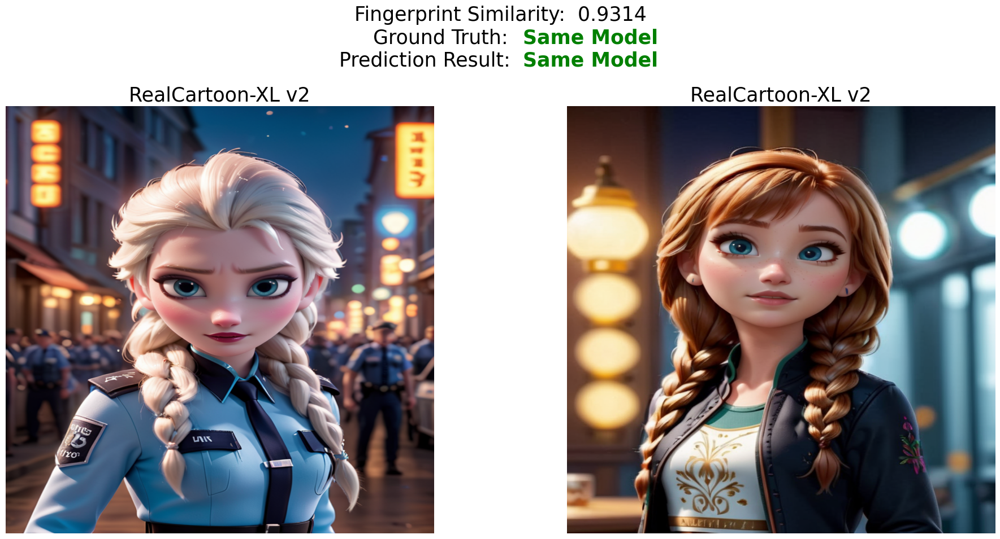

In [90]:
# from: https://image.civitai.com/xG1nkqKTMzGDvpLrqFT7WA/cb8b32b7-c107-4261-92e4-f8b60f3f35b3/original=true/00364-1446733594.png
img_path1 = './dataset/demo_samples/civitai/Elsa_RealCartoonXL/00364-1446733594.png' 

# from: https://image.civitai.com/xG1nkqKTMzGDvpLrqFT7WA/bbd81c8e-9e87-4282-9645-6b65965ee8d4/original=true/00371-1761944231.png
img_path2 = './dataset/demo_samples/civitai/Elsa_RealCartoonXL/00371-1761944231.png' 

model_verify(img_path1, img_path2, gt_source=['RealCartoon-XL v2', 'RealCartoon-XL v2'])

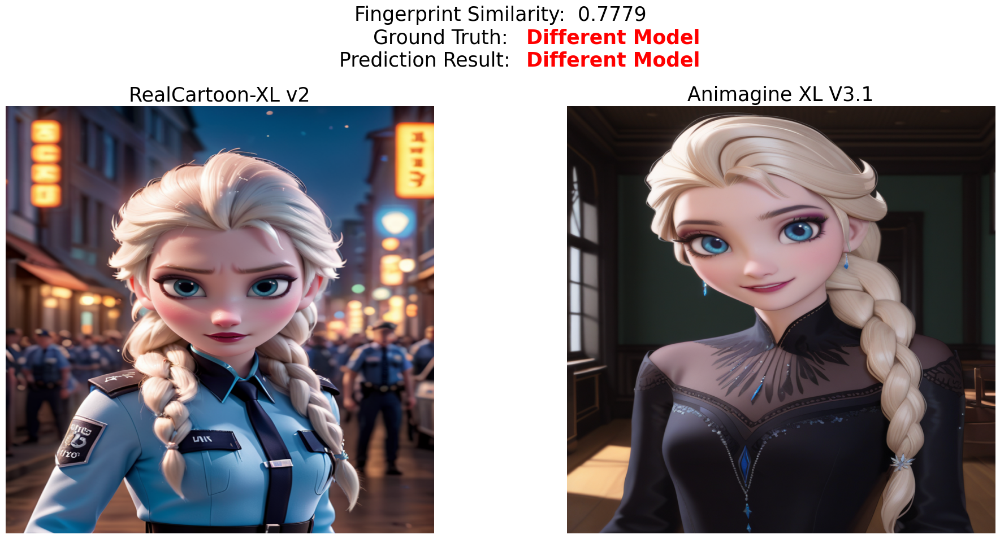

In [91]:
# from: https://image.civitai.com/xG1nkqKTMzGDvpLrqFT7WA/cb8b32b7-c107-4261-92e4-f8b60f3f35b3/original=true/00364-1446733594.png
img_path1 = './dataset/demo_samples/civitai/Elsa_RealCartoonXL/00364-1446733594.png' 

# from: https://image.civitai.com/xG1nkqKTMzGDvpLrqFT7WA/57c3d5ed-b283-47f4-a518-38da5628c82b/original=true/00001-783365548.png
img_path2 = './dataset/demo_samples/civitai/Elsa_AnimagineXL/00001-2652805523.png'

model_verify(img_path1, img_path2, gt_source=['RealCartoon-XL v2', 'Animagine XL V3.1'])

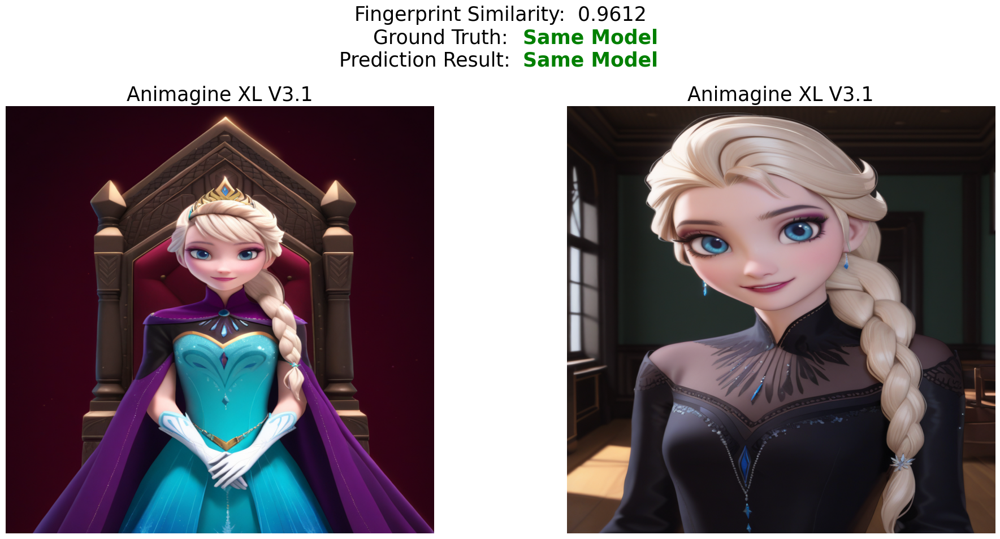

In [92]:
# from: https://image.civitai.com/xG1nkqKTMzGDvpLrqFT7WA/c49d9ed1-74bf-479e-bc54-a40354470cc6/original=true/00001-1867360684.png
img_path1 = './dataset/demo_samples/civitai/Elsa_AnimagineXL/00001-1867360684.png'

# from: https://image.civitai.com/xG1nkqKTMzGDvpLrqFT7WA/74fb67dc-875c-4327-963c-728174180bc9/original=true/00001-2652805523.png
img_path2 = './dataset/demo_samples/civitai/Elsa_AnimagineXL/00001-2652805523.png'

model_verify(img_path1, img_path2, gt_source=['Animagine XL V3.1', 'Animagine XL V3.1'])

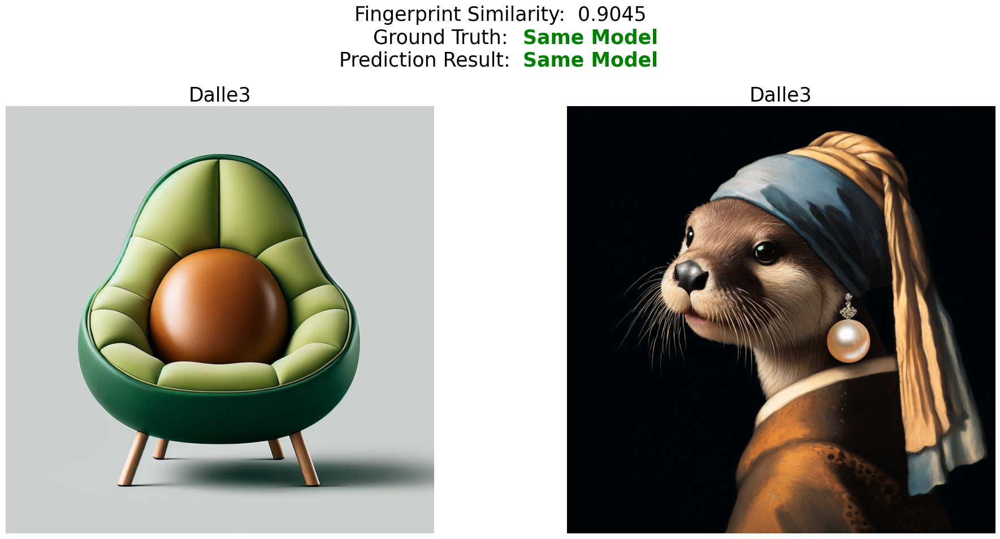

In [93]:
# generated by DallE-3 in ChatGPT
# prompt: An armchair in the shape of an avocado
img_path1 = './dataset/demo_samples/Dalle3_chatgpt/armchair.png' 

# generated by DallE-3 in ChatGPT
# prompt: "A sea otter with a pearl earring" by Johannes Vermeer
img_path2 = './dataset/demo_samples/Dalle3_chatgpt/sea_otter.png' 

model_verify(img_path1, img_path2, gt_source=['Dalle3', 'Dalle3'])

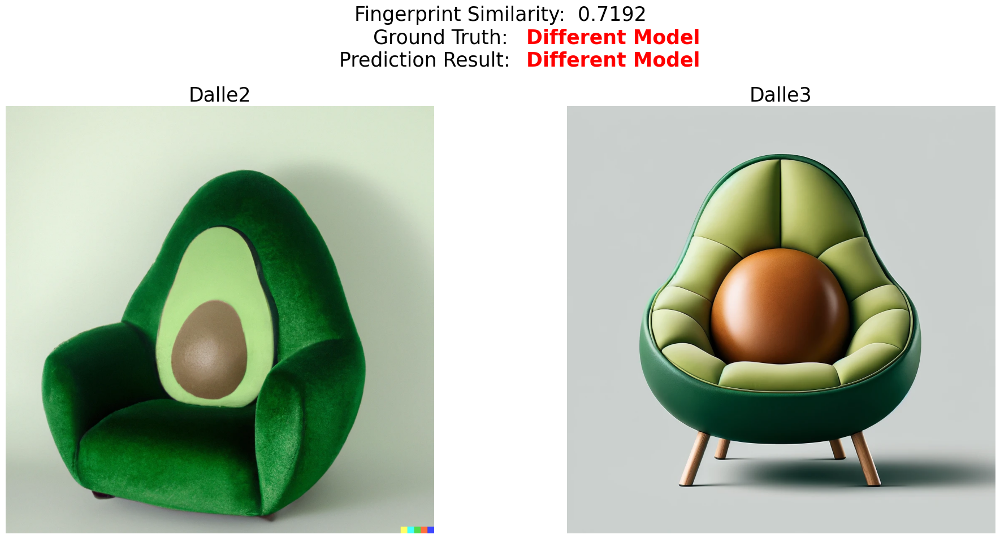

In [94]:
# from the show cases on Dalle-2 webpage: https://cdn.openai.com/labs/images/An%20armchair%20in%20the%20shape%20of%20an%20avocado.webp?v=1
# prompt: An armchair in the shape of an avocado
img_path1 = './dataset/demo_samples/Dalle2_webpage/An armchair in the shape of an on avocado.png' 

# generated by DallE-3 in ChatGPT
# prompt: An armchair in the shape of an avocado
img_path2 = './dataset/demo_samples/Dalle3_chatgpt/armchair.png'  

model_verify(img_path1, img_path2, gt_source=['Dalle2', 'Dalle3'])

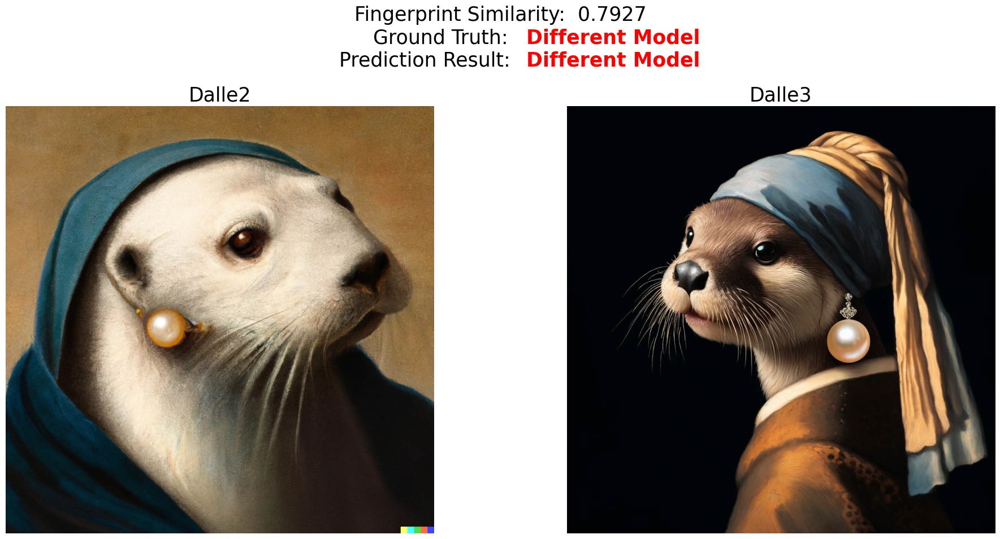

In [95]:
# from the show cases on Dalle-2 webpage: https://cdn.openai.com/labs/images/%22A%20sea%20otter%20with%20a%20pearl%20earring%22%20by%20Johannes%20Vermeer.webp?v=1
# prompt: "A sea otter with a pearl earring" by Johannes Vermeer
img_path1 = './dataset/demo_samples/Dalle2_webpage/_A sea otter with a pearl earring_ by Johannes Vermeer.png' 

# generated by DallE-3 in ChatGPT
# prompt: "A sea otter with a pearl earring" by Johannes Vermeer
img_path2 = './dataset/demo_samples/Dalle3_chatgpt/sea_otter.png' 
model_verify(img_path1, img_path2, gt_source=['Dalle2', 'Dalle3'])

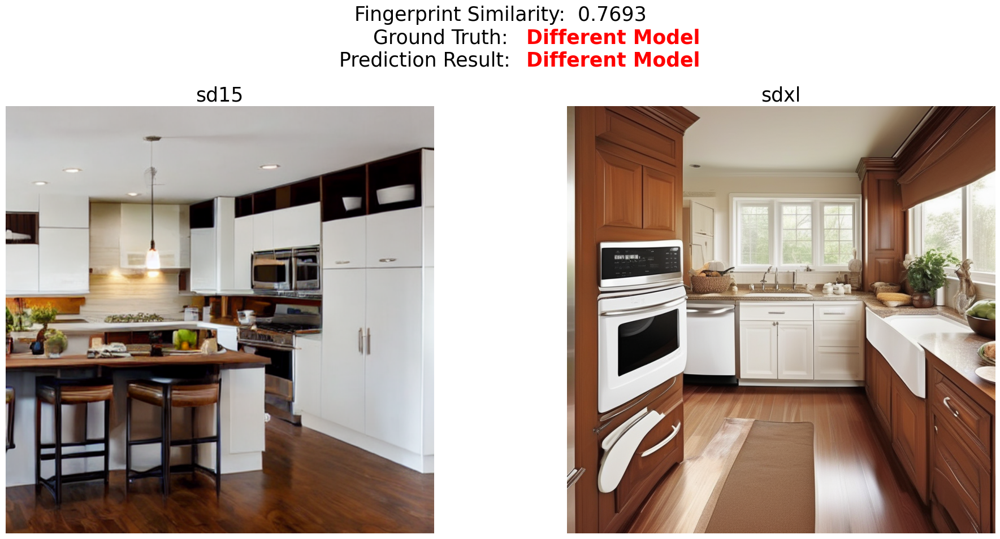

In [96]:
# generated by SD15
# prompt: Stark white appliances stand out against brown wooden cabinets.
img_path1 = './dataset/demo_samples/stable_diffusion_v15/000000000802.png'

# generated by SDXL
# prompt: Stark white appliances stand out against brown wooden cabinets.
img_path2 = './dataset/demo_samples/stable_diffusion_xl/000000000802.png'
model_verify(img_path1, img_path2, gt_source=['sd15', 'sdxl'])

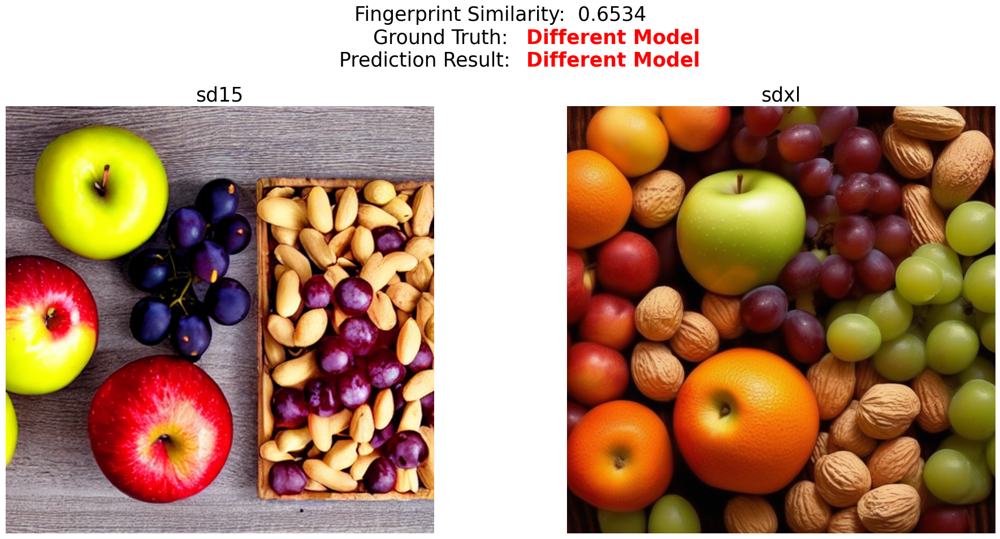

In [97]:
# generated by SD15
# prompt: Two apples, an orange, some grapes and peanuts.
img_path1 = './dataset/demo_samples/stable_diffusion_v15/000000006614.png'

# generated by SDXL
# prompt: Two apples, an orange, some grapes and peanuts.
img_path2 = './dataset/demo_samples/stable_diffusion_xl/000000006614.png'

model_verify(img_path1, img_path2, gt_source=['sd15', 'sdxl'])

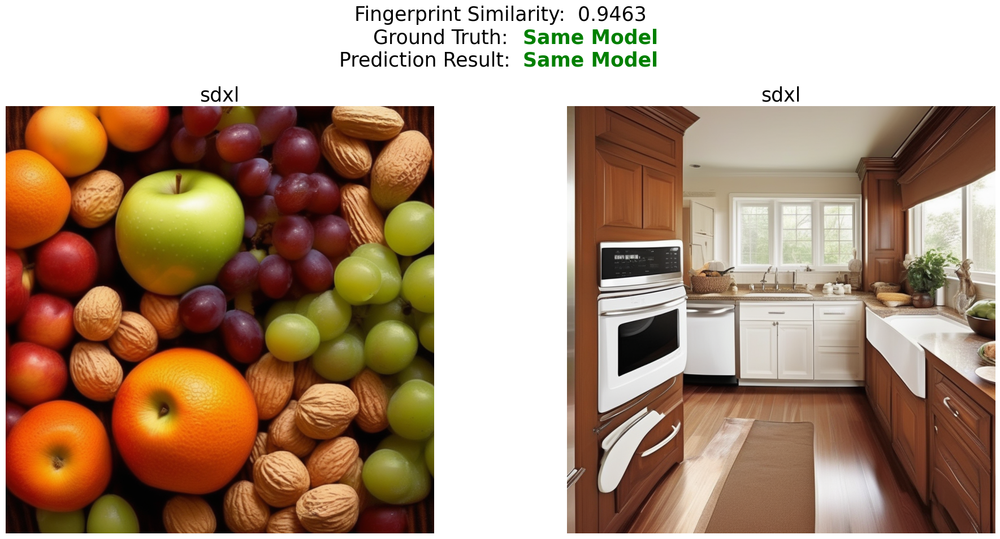

In [98]:
# generated by SDXL
# prompt: Two apples, an orange, some grapes and peanuts.
img_path1 = './dataset/demo_samples/stable_diffusion_xl/000000006614.png'

# generated by SDXL
# prompt: Stark white appliances stand out against brown wooden cabinets.
img_path2 = './dataset/demo_samples/stable_diffusion_xl/000000000802.png'
model_verify(img_path1, img_path2, gt_source=['sdxl', 'sdxl'])

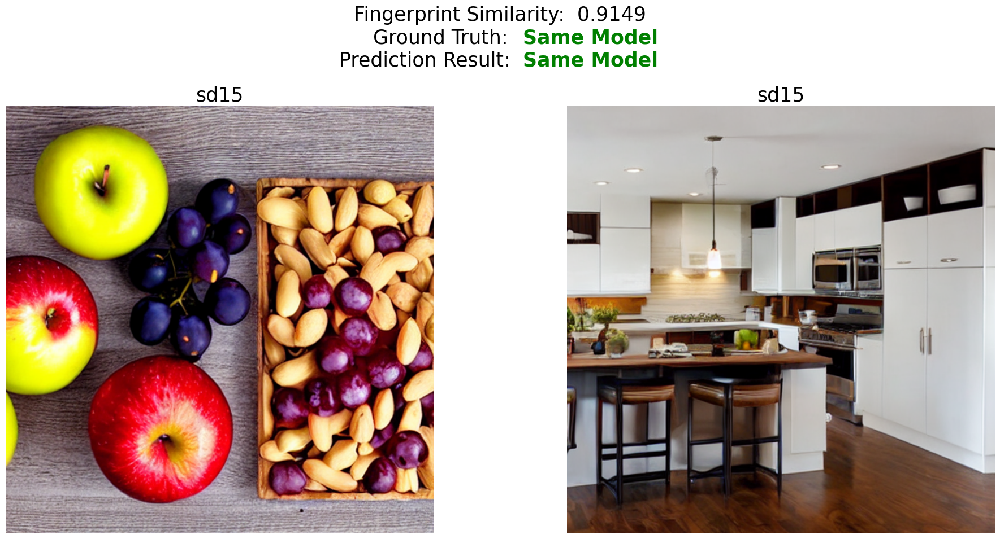

In [99]:
# generated by SD15
# prompt: Two apples, an orange, some grapes and peanuts.
img_path1 = './dataset/demo_samples/stable_diffusion_v15/000000006614.png'

# generated by SD15
# prompt: Stark white appliances stand out against brown wooden cabinets.
img_path2 = './dataset/demo_samples/stable_diffusion_v15/000000000802.png'
model_verify(img_path1, img_path2, gt_source=['sd15', 'sd15'])

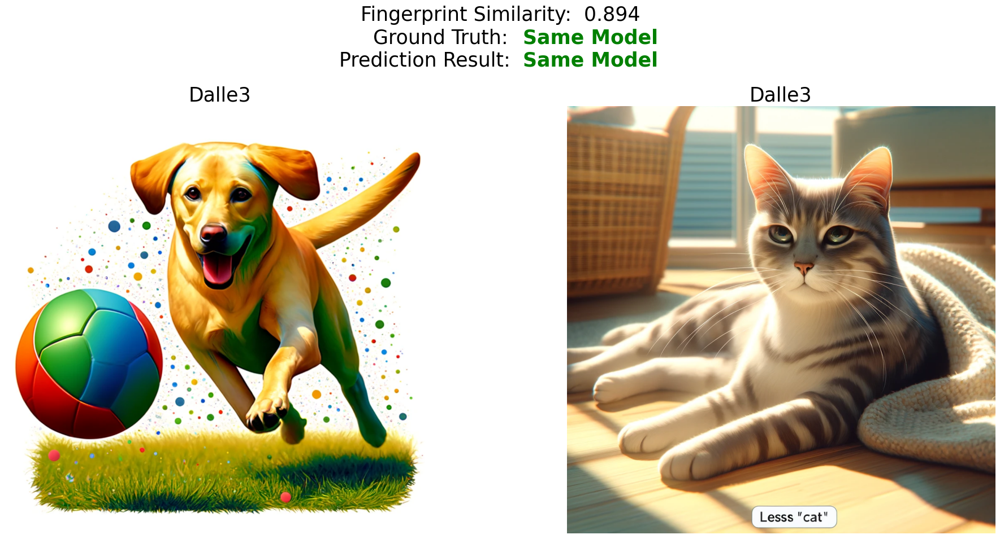

In [100]:
# a dog generated by DallE-3 in ChatGPT
img_path1 = './dataset/demo_samples/Dalle3_chatgpt/dog.png' 

# a cat generated by DallE-3 in ChatGPT
img_path2 = './dataset/demo_samples/Dalle3_chatgpt/cat.png' 

model_verify(img_path1, img_path2, gt_source=['Dalle3', 'Dalle3'])

## TSNE Visualization on Extracted Fingerprints of Images Generated by 32 Real Generative Models


In [28]:
import random
import numpy as np
import matplotlib.pyplot as plt
params = {'legend.fontsize': 'xx-large',
          'figure.figsize': (8, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

def plot_tsne(tsne_data, classes, selected_feature_num = 2000, legend_fontsize=15):
    
    embeddings=np.load(tsne_data, allow_pickle=True)[:selected_feature_num]
    labels=np.load(tsne_data.replace('embeddings','labels'), allow_pickle=True)[:selected_feature_num]

    index = [i for i in range(len(embeddings))]
    random.shuffle(index)
    embeddings = np.array([embeddings[index[i]] for i in range(len(index))])
    labels = [labels[index[i]] for i in range(len(index))]

    print(f">>> draw image begin")
    vis_x = embeddings[:, 0]
    vis_y = embeddings[:, 1]
    for i, lab in enumerate(list(set(labels))):
        if i < 20:
            color = plt.cm.tab20(i)
        elif i<40:
            color = plt.cm.tab20b(i-20)
        else:
            color = plt.cm.tab20c(i-40)
        class_index = [j for j,v in enumerate(labels) if v == lab]
        plt.scatter(vis_x[class_index], vis_y[class_index], color = color, alpha=1, marker='*', s=80)

    plt.xticks([])
    plt.yticks([])
#     plt.legend(classes, loc='best',fontsize=legend_fontsize)

        # Add the legend outside of the plot
    plt.legend(classes, loc='upper left', bbox_to_anchor=(1.2, 1), fontsize='small')

    # Adjust layout to avoid overlap with the legend
    plt.tight_layout(rect=[0, 0, 1, 1])


    plt.show()
    print(f"<<< draw image end")

In [29]:
from test_1v1 import Tester

class args(object): 
    device=device
    window_slide=True

save_dir ='./results/pred'
tester = Tester(model, denoise_func, save_dir, config, args)

subset_data1
8/8 [==============================] - 11s 1s/step - run-type: tsne
./results/pred/tsne/subset_data1.png
>>> t-SNE fitting
<<< fitting over
./results/pred/tsne/embeddings_subset_data1.npy
>>> draw image begin
num_classes 16
>>> draw image begin


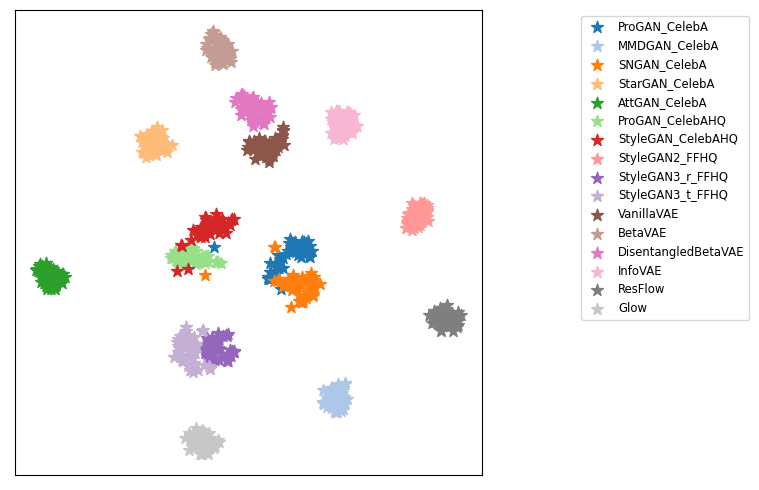

<<< draw image end


In [32]:
test_data_path = './dataset/data_list/subset_data1.txt'
test_data_name = os.path.basename(test_data_path)[:-4]

# tsne_analysis
tester.tsne_analysis(test_data_path, run_type=test_data_name)

# draw tsne data
tsne_data = f'./results/pred/tsne/embeddings_{test_data_name}.npy'
classes = ['ProGAN_CelebA', 'MMDGAN_CelebA', 'SNGAN_CelebA', 'StarGAN_CelebA', 'AttGAN_CelebA', \
           'ProGAN_CelebAHQ', 'StyleGAN_CelebAHQ', 'StyleGAN2_FFHQ', 'StyleGAN3_r_FFHQ', 'StyleGAN3_t_FFHQ'] + \
            ['VanillaVAE', 'BetaVAE', 'DisentangledBetaVAE', 'InfoVAE']  + ['ResFlow', 'Glow'] 

plot_tsne(tsne_data, classes)

8/8 [==============================] - 11s 1s/step - run-type: tsne
./results/pred/tsne/subset_data2.png
>>> t-SNE fitting
<<< fitting over
./results/pred/tsne/embeddings_subset_data2.npy
>>> draw image begin
num_classes 16
>>> draw image begin


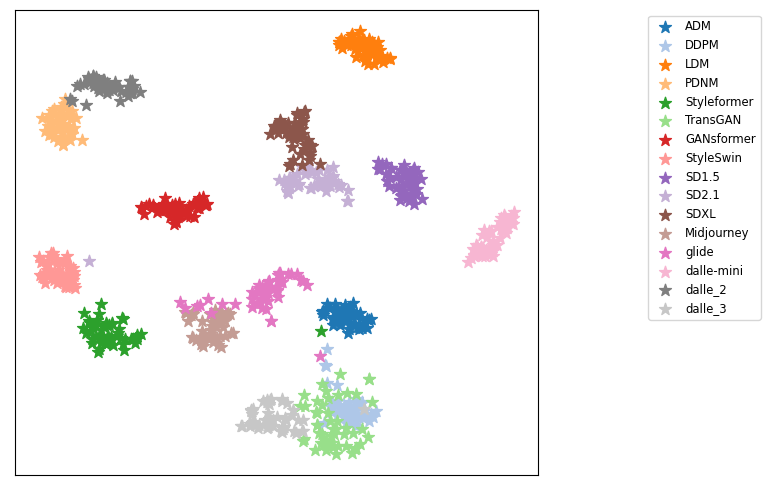

<<< draw image end


In [33]:
# Note:
# The samples of Dalle3 in this dataset are from: https://huggingface.co/datasets/OpenDatasets/dalle-3-dataset
# The samples of Midjourney in this dataset are from: https://www.kaggle.com/datasets/da9b9ba35ffbd86a5f97ccd068d3c74f5742cfe5f34f6aaf1f0f458d7694f55e

# Due to version changing or processiongs in collection, these samples may not correspond to the current online model versions. We show the online cases in the 1:1 verification cases above.

test_data_path = './dataset/data_list/subset_data2.txt'
test_data_name = os.path.basename(test_data_path)[:-4]

# tsne_analysis
tester.tsne_analysis(test_data_path, run_type=test_data_name)

# draw tsne data
tsne_data = f'./results/pred/tsne/embeddings_{test_data_name}.npy'
classes = ['ADM', 'DDPM', 'LDM', 'PDNM']  + \
      ['Styleformer', 'TransGAN', 'GANsformer', 'StyleSwin']  + \
      ['SD1.5', 'SD2.1', 'SDXL', 'Midjourney', 'glide', 'dalle-mini', 'dalle_2', 'dalle_3'] 

plot_tsne(tsne_data, classes)